<p style="text-align: center; font-size: 32px; font-weight: bold;">Segmentez des clients d'un site e-commerce</p>




![alt text](OlistCapture.png)


## Préambule

L'e-commerce est un modèle d'entreprise qui permet aux sociétés ou aux particuliers d'acheter ou de vendre des biens via Internet. Les clients du commerce électronique ont une variété de personnalités, et un marché potentiel n'est généralement pas caractérisé de manière unique ni facilement. Il devient important de connaître la base de clients cible afin de s'assurer que les communications sont à la fois efficaces (attrayantes, favorisant l'action) et appropriées (non offensantes, opportunes et pertinentes). L'analyse RFM est une technique de segmentation du comportement des clients. Basée sur les transactions historiques des clients, l'analyse RFM se concentre sur 3 aspects principaux des transactions des clients : la récence, la fréquence et le montant des achats. Comprendre ces comportements permettra aux entreprises de regrouper différents clients en groupes.

### Mission et Objectif


Dans le cadre de ce projet, ma mission en tant que data scientist chez Olist, une entreprise brésilienne proposant une solution de vente sur les marketplaces en ligne, est d'aider les équipes d'e-commerce à comprendre les différents types d'utilisateurs en analysant leur comportement et leurs données personnelles. L'objectif principal est de fournir à l'équipe marketing une segmentation des clients avec une description détaillée et une logique sous-jacente claire. Cette segmentation permettra une communication ciblée et efficace pour optimiser les campagnes de marketing.

# Découverte des insights pour une segmentation efficace (EDA)


<a id='sec:introduction'></a>
## I. Introduction

Ce premier notebook se concentre sur l'analyse exploratoire des données (EDA) afin de découvrir des insights et des tendances essentiels pour une segmentation efficace des clients dans le cadre de notre projet. En examinant les différentes variables telles que l'historique des commandes, les produits achetés, les évaluations de satisfaction et les localisations des clients, nous pourrons mieux comprendre le comportement des utilisateurs. Cette analyse approfondie nous permettra d'identifier des motifs et des corrélations significatifs entre les variables, de repérer d'éventuelles valeurs aberrantes ou données manquantes, et de visualiser les données de manière claire et concise. Ces insights initiaux nous aideront à formuler des hypothèses et à orienter notre approche pour la segmentation des clients.

In [ ]:
# pour editer le jeu de donne
import pandas as pd
import numpy as np
import datetime as dt
import time
from IPython.display import Image
# pour visualiser 
import seaborn as sns
import matplotlib.pyplot as plt
import missingno as msno
import plotly.express as px
import plotly.figure_factory as ff
from plotly import __version__
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import chart_studio.plotly as py
import cufflinks as cf 
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import importlib.metadata


# For Notebooks
init_notebook_mode(connected=True)
# For offline use
cf.go_offline()
%matplotlib inline

In [2]:
#Modification des affichages de colonnes, lignes et largeurs de colonnes pour avoir un maximum d'information
pd.set_option('display.max_columns', 200)
pd.set_option('display.max_rows', 1000)
pd.set_option('display.max_colwidth', None)

In [3]:
!python --version

# Version des librairies utilisées
print('\n'.join(f'{m.__name__} - {m.__version__}' 
                for m in globals().values() 
                if getattr(m, '__version__', None)))

print("matplotlib - ", importlib.metadata.version('matplotlib'))

Python 3.8.3
pandas - 2.0.3
numpy - 1.23.5
seaborn - 0.12.2
missingno - 0.4.2
cufflinks - 0.17.3
matplotlib -  3.6.2


![Olist](olist.png)

In [4]:
customers = pd.read_csv("olist_customers_dataset.csv") #des informations sur les clients.
sellers = pd.read_csv('olist_sellers_dataset.csv') # des informations sur les vendeurs.
products = pd.read_csv("olist_products_dataset.csv") # des informations sur les produits.

orders  = pd.read_csv("olist_orders_dataset.csv") # Permet de comprendre les détails des commandes.
order_items = pd.read_csv("olist_order_items_dataset.csv")# des informations sur les articles chaque commande.
order_payments = pd.read_csv('olist_order_payments_dataset.csv') # Des info les paiements effectués 
order_review = pd.read_csv("olist_order_reviews_dataset.csv") # les avis et les notes de satisfaction des clients 

geolocation = pd.read_csv('olist_geolocation_dataset.csv') # des informations de géolocalisation 
name_translation = pd.read_csv("product_category_name_translation.csv")#  les traductions de produits en anglais.

La base de données Olist comprend plusieurs fichiers contenant des informations essentielles pour notre projet de segmentation des clients. Chaque fichier est connecté à d'autres fichiers via des identifiants uniques, ce qui nous permet de relier les différentes sources de données et d'obtenir une vue complète du système Olist. Voici une brève explication des connexions entre les fichiers :



![Table](Table.png)

Le fichier "customers" contient des informations sur les clients et est connecté au fichier "orders" par le biais de l'identifiant unique "customer_id". Cela nous permet de relier les informations de chaque client à ses commandes correspondantes.

Le fichier "sellers" fournit des informations sur les vendeurs et est connecté au fichier "order_items" via l'identifiant unique "seller_id". Cela nous permet de relier les articles de chaque commande aux vendeurs correspondants.

Le fichier "products" contient des informations sur les produits et est connecté au fichier "order_items" par le biais de l'identifiant unique "product_id". Cela nous permet de relier chaque article de commande aux produits correspondants.

Le fichier "order_items" est également connecté au fichier "orders" via l'identifiant unique "order_id". Cela nous permet de comprendre les détails spécifiques de chaque commande, tels que les quantités d'articles et les prix.

Le fichier "order_payments" contient des informations sur les paiements effectués pour chaque commande et est connecté au fichier "orders" via l'identifiant unique "order_id". Cela nous permet de lier les informations de paiement à chaque commande spécifique.

Le fichier "order_review" contient les avis et les notes de satisfaction des clients et est également connecté au fichier "orders" via l'identifiant unique "order_id". Cela nous permet de relier les évaluations des clients à leurs commandes correspondantes.

Le fichier "geolocation" contient des informations de géolocalisation et est connecté aux fichiers "customers" et "sellers" via le préfixe du code postal. Cela nous permet de relier les données de localisation aux clients et aux vendeurs respectifs.

En utilisant ces connexions entre les fichiers, nous pourrons effectuer des analyses approfondies et obtenir des informations précieuses sur le comportement des clients dans le système Olist.

### Customers

In [5]:
customers.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 5 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   customer_id               99441 non-null  object
 1   customer_unique_id        99441 non-null  object
 2   customer_zip_code_prefix  99441 non-null  int64 
 3   customer_city             99441 non-null  object
 4   customer_state            99441 non-null  object
dtypes: int64(1), object(4)
memory usage: 3.8+ MB


In [6]:
display(customers.head(5))

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


In [7]:
unique_counts_customers = customers.nunique()
print(unique_counts_customers)

customer_id                 99441
customer_unique_id          96096
customer_zip_code_prefix    14994
customer_city                4119
customer_state                 27
dtype: int64


Le customer_unique_id est l'identifiant unique du client dans le dataset. Dans le cadre du projet de segmentation des clients, nous utiliserons cet identifiant pour regrouper les clients en fonction de leurs caractéristiques et comportements communs. Il est important de noter que le même client peut avoir plusieurs customer_id car il peut effectuer plusieurs commandes ou être enregistré plusieurs fois dans le système avec des informations légèrement différentes. En utilisant le customer_unique_id, nous pouvons nous assurer que chaque client est représenté de manière unique dans notre analyse. Le customer_unique_id nous permet de suivre le comportement d'achat et les caractéristiques des clients individuels indépendamment des variations dans les autres attributs tels que l'identifiant du client ou l'emplacement géographique.

In [8]:
# Compter le nombre de clients dans chaque état
state_counts = customers['customer_state'].value_counts()

# Créer le diagramme circulaire
fig = go.Figure(data=[go.Pie(labels=state_counts.index, values=state_counts)])

# Modifier la taille du diagramme
fig.update_layout(
    title='Répartition des clients par État',
    width=1000,  # Largeur du diagramme
    height=800  # Hauteur du diagramme
)

# Modifier l'affichage des étiquettes
fig.update_traces(
    textposition='inside',  # Afficher les étiquettes à l'intérieur du diagramme
    textinfo='percent+label'  # Afficher le pourcentage et l'étiquette de chaque état
)

# Afficher le diagramme
fig.show()


Le diagramme circulaire représente la répartition des clients par État au Brésil. Les données montrent que la majorité des clients proviennent des États de São Paulo (SP), Rio de Janeiro (RJ), Minas Gerais (MG), Rio Grande do Sul (RS) et Paraná (PR). L'État de São Paulo compte le plus grand nombre de clients, représentant environ 42% de l'ensemble des clients. Ensuite, l'État de Rio de Janeiro constitue environ 13% des clients, suivi de près par l'État de Minas Gerais avec 11,7%. Les États de Rio Grande do Sul et Paraná ont également une présence significative avec respectivement 5,5% et 5,07% des clients. Ces résultats soulignent l'importance de se concentrer sur ces États lors de la planification des stratégies de communication et de marketing afin de mieux cibler la majorité des clients et de maximiser l'efficacité des campagnes

## Sellers

In [9]:
sellers.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3095 entries, 0 to 3094
Data columns (total 4 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   seller_id               3095 non-null   object
 1   seller_zip_code_prefix  3095 non-null   int64 
 2   seller_city             3095 non-null   object
 3   seller_state            3095 non-null   object
dtypes: int64(1), object(3)
memory usage: 96.8+ KB


In [10]:
display(sellers.head(5))

,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP


In [11]:
unique_counts_sellers = sellers.nunique()
print(unique_counts_sellers)

seller_id                 3095
seller_zip_code_prefix    2246
seller_city                611
seller_state                23
dtype: int64


In [12]:
# Compter le nombre de clients dans chaque état
state_counts_sellers = sellers['seller_state'].value_counts()

# Créer le diagramme circulaire
fig = go.Figure(data=[go.Pie(labels=state_counts_sellers.index, values=state_counts_sellers)])

# Modifier la taille du diagramme
fig.update_layout(
    title='Répartition des vendeur par État',
    width=1000,  # Largeur du diagramme
    height=800  # Hauteur du diagramme
)

# Modifier l'affichage des étiquettes
fig.update_traces(
    textposition='inside',  # Afficher les étiquettes à l'intérieur du diagramme
    textinfo='percent+label'  # Afficher le pourcentage et l'étiquette de chaque état
)

# Afficher le diagramme
fig.show()

Le diagramme circulaire ci-dessus présente la répartition des vendeurs par État au Brésil. Les résultats indiquent que l'État de São Paulo (SP) représente la majorité des vendeurs, avec environ 59,7%. Ensuite, nous avons l'État du Paraná (PR) avec environ 11,3%, suivi de près par l'État de Minas Gerais (MG) avec environ 7,9%. Les États de Santa Catarina (SC) et Rio de Janeiro (RJ) ont également une présence significative, avec respectivement environ 6,1% et 5,5%. Ces informations sont précieuses pour Olist dans la gestion et le soutien des vendeurs dans différentes régions du pays.

# Products

In [13]:
products.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32951 entries, 0 to 32950
Data columns (total 9 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   product_id                  32951 non-null  object 
 1   product_category_name       32341 non-null  object 
 2   product_name_lenght         32341 non-null  float64
 3   product_description_lenght  32341 non-null  float64
 4   product_photos_qty          32341 non-null  float64
 5   product_weight_g            32949 non-null  float64
 6   product_length_cm           32949 non-null  float64
 7   product_height_cm           32949 non-null  float64
 8   product_width_cm            32949 non-null  float64
dtypes: float64(7), object(2)
memory usage: 2.3+ MB


In [14]:
display(products.head(5))

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0


In [15]:
unique_counts_products = products.nunique()
print(unique_counts_products)

product_id                    32951
product_category_name            73
product_name_lenght              66
product_description_lenght     2960
product_photos_qty               19
product_weight_g               2204
product_length_cm                99
product_height_cm               102
product_width_cm                 95
dtype: int64


In [ ]:

# Calculate the volume of the products
products['product_volume_cm3'] = products['product_length_cm'] * products['product_height_cm'] * products['product_width_cm']


fig = px.scatter(products, x='product_weight_g', y='product_volume_cm3', title='Poids vs Volume des produits')
fig.update_layout(xaxis_title='Poids du produit (g)', yaxis_title='Volume du produit (cm³)')
fig.show()


In [ ]:
products[products['product_weight_g']>40000]

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,product_volume_cm3
25166,26644690fde745fc4654719c3904e1db,cama_mesa_banho,59.0,534.0,1.0,40425.0,13.0,65.0,28.0,23660.0


In [18]:
products[products['product_weight_g']==30000]['product_category_name'].value_counts()

product_category_name
beleza_saude                                      29
moveis_decoracao                                  13
esporte_lazer                                     13
moveis_sala                                       12
utilidades_domesticas                             12
moveis_escritorio                                  9
moveis_cozinha_area_de_servico_jantar_e_jardim     7
ferramentas_jardim                                 6
bebes                                              5
automotivo                                         5
cool_stuff                                         4
pet_shop                                           4
cama_mesa_banho                                    3
casa_construcao                                    3
industria_comercio_e_negocios                      2
construcao_ferramentas_construcao                  2
moveis_colchao_e_estofado                          2
instrumentos_musicais                              2
eletrodomesticos        

In [19]:
name_translation.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 71 entries, 0 to 70
Data columns (total 2 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   product_category_name          71 non-null     object
 1   product_category_name_english  71 non-null     object
dtypes: object(2)
memory usage: 1.2+ KB


In [20]:
# Convert cm3 to m3 and g to kg
products['product_volume_m3'] = products['product_volume_cm3'] / 1000000
products['product_weight_kg'] = products['product_weight_g'] / 1000

# Merge with name_translation dataset to get English translations
products = products.merge(name_translation, on='product_category_name', how='left')

In [21]:


# Group the products dataset by category name and calculate the mean weight and mean volume
category_data = products.groupby('product_category_name_english').agg({'product_weight_kg': 'mean', 'product_volume_m3': 'mean'})
category_data = category_data.sort_values(by='product_weight_kg', ascending=False).head(15)

# Create the subplot with two bar plots
fig = make_subplots(rows=2, cols=1, subplot_titles=("Volume moyen (m^3)", "Poids moyen (kg)"), vertical_spacing=0.5)


# Bar plot for mean volume
fig.add_trace(go.Bar(
    x=category_data.index,
    y=category_data['product_volume_m3'],
    marker_color='blue',
    name='Volume moyen (m^3)'
), row=1, col=1)

# Bar plot for mean weight
fig.add_trace(go.Bar(
    x=category_data.index,
    y=category_data['product_weight_kg'],
    marker_color='green',
    name='Poids moyen (kg)'
), row=2, col=1)

# Update layout
fig.update_layout(
    title='Volume et poids moyen des 15 catégories les plus courantes',
    xaxis_tickangle=-45,
    xaxis=dict(tickfont=dict(size=12)),
    yaxis=dict(title='Valeur'),
    barmode='group',
    showlegend=True,
    height=800,
    width=1000
)

# Show the plot
fig.show()


In [22]:
products = products.drop(axis=1,
columns=['product_name_lenght',
'product_description_lenght',
'product_photos_qty',
'product_weight_g',
'product_length_cm',
'product_height_cm',
'product_width_cm',
'product_volume_cm3',
'product_volume_m3',
'product_weight_kg'])

<AxesSubplot: >

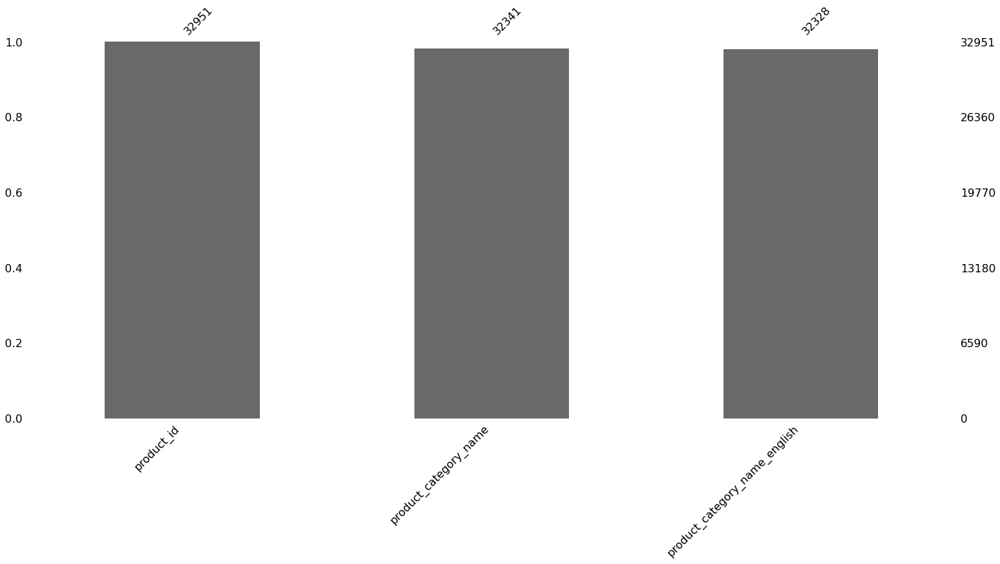

In [23]:
msno.bar(products)

In [24]:
# Check which category names don't have an English translation
missing_translation = products[products['product_category_name_english'].isnull()]['product_category_name'].unique()

# Print the category names without an English translation
print("Category names without an English translation:")
for category_name in missing_translation:
    print(category_name)


Category names without an English translation:
nan
pc_gamer
portateis_cozinha_e_preparadores_de_alimentos


In [25]:
products.loc[products['product_category_name'] == 'portateis_cozinha_e_preparadores_de_alimentos', 'product_category_name_english'] = 'Portable Kitchen and Food Preparers'
products.loc[products['product_category_name'] == 'pc_gamer', 'product_category_name_english'] = 'PC Gamer'
products.loc[products['product_category_name'] == 'nan', 'product_category_name'] = 'Unknown'

In [26]:
products['product_category_name'] = products['product_category_name'].fillna('Unknown')
products['product_category_name_english'] = products['product_category_name_english'].fillna('Unknown')


In [27]:
products['product_category_name_english'].value_counts()

product_category_name_english
bed_bath_table                             3029
sports_leisure                             2867
furniture_decor                            2657
health_beauty                              2444
housewares                                 2335
auto                                       1900
computers_accessories                      1639
toys                                       1411
watches_gifts                              1329
telephony                                  1134
baby                                        919
perfumery                                   868
fashion_bags_accessories                    849
stationery                                  849
cool_stuff                                  789
garden_tools                                753
pet_shop                                    719
Unknown                                     610
electronics                                 517
construction_tools_construction             400
home_appli

Dans cette analyse, nous avons exploré les informations sur les produits, y compris les noms de catégories de produits et les noms de catégories principales. À l'aide d'un dictionnaire Python, nous avons associé chaque catégorie de produit à sa catégorie principale correspondante.

In [28]:
category_mapping = {
    'bed_bath_table': 'home',
    'furniture_decor': 'home',
    'furniture_living_room': 'home',
    'furniture_bedroom': 'home',
    'furniture_mattress_and_upholstery': 'home',

    'home_construction': 'housewares',
    'kitchen_dining_laundry_garden_furniture': 'housewares',
    'home_confort': 'housewares',
    'home_comfort_2': 'housewares',
    'housewares': 'housewares',

    
    'sports_leisure': 'leisure',
    'toys': 'leisure',
    'cool_stuff': 'leisure',
    'consoles_games': 'leisure',
    'cine_photo': 'leisure',
    'arts_and_craftmanship': 'leisure',
    'art': 'leisure',
    'auto': 'leisure',
    
    'audio': 'music',
    'cds_dvds_musicals': 'music',
    'music': 'music',
    'dvds_blu_ray': 'music',
    'musical_instruments': 'music',
    
    'health_beauty': 'beauty and hygiene',
    'perfumery': 'beauty and hygiene',
    'diapers_and_hygiene': 'beauty and hygiene',
    
    'computers_accessories': 'electronics',
    'telephony': 'electronics',
    'electronics': 'electronics',
    'computers': 'electronics',
    'PC Gamer': 'electronics',
    'fixed_telephony': 'electronics',
    'tablets_printing_image': 'electronics',

    
    'watches_gifts': 'fashion',
    'fashion_bags_accessories': 'fashion',
    'fashion_shoes': 'fashion',
    'fashion_male_clothing': 'fashion',
    'fashio_female_clothing': 'fashion',
    'fashion_underwear_beach': 'fashion',
    'fashion_sport': 'fashion',
    'fashion_childrens_clothes': 'fashion',
    
    'baby': 'baby',
    
    'stationery': 'office',
    'office_furniture': 'office',
    
    'garden_tools': 'garden_outdoors',
    'flowers': 'garden_outdoors', 
    'signaling_and_security': 'garden_outdoors',

    'pet_shop': 'pets',
    
    'christmas_supplies': 'decoration',
    'party_supplies': 'decoration',
    
    
    'home_appliances': 'appliances',
    'home_appliances_2': 'appliances',
    'small_appliances_kitchen_and_food_processors': 'appliances',
    'small_appliances_home_oven_and_coffee': 'appliances',
    'small_appliances': 'appliances',
    'air_conditioning': 'appliances',
    
    'books_general_interest': 'books',
    'books_technical': 'books',
    'books_imported': 'books',
    
    'luggage_accessories': 'travel',
    
    'construction_tools_construction': 'tools',
    'costruction_tools_garden': 'tools',
    'construction_tools_safety': 'tools',
    'costruction_tools_tools': 'tools',
    'construction_tools_lights': 'tools',
    
    'food_drink': 'food_drinks',
    'food': 'food_drinks',
    'drinks': 'food_drinks',
    
    'agro_industry_and_commerce': 'industry_commerce',
    'industry_commerce_and_business': 'industry_commerce',
    
    'la_cuisine': 'kitchen',
    'Portable Kitchen and Food Preparers': 'kitchen',
    
    'security_and_services': 'services',
    'market_place' : 'service',   

    'Unknown': 'others'

}


# Create a new column 'category_group' based on the mapping
products['main_category_group'] = products['product_category_name_english'].map(category_mapping)

# Display the updated dataframe
print(products[['product_category_name_english', 'main_category_group']])

      product_category_name_english main_category_group
0                         perfumery  beauty and hygiene
1                               art             leisure
2                    sports_leisure             leisure
3                              baby                baby
4                        housewares          housewares
...                             ...                 ...
32946               furniture_decor                home
32947     construction_tools_lights               tools
32948                bed_bath_table                home
32949         computers_accessories         electronics
32950                bed_bath_table                home

[32951 rows x 2 columns]


Nous avons créé un histogramme pour visualiser la fréquence de chaque nom de catégorie principale. Les résultats ont révélé les catégories principales les plus consommées, classées comme suit : Loisirs, Maison, Électronique, Beauté et Hygiène, Articles ménagers, Mode, Bureau, Bébé et Jardin & Extérieur.

In [102]:
# Create the histogram using Plotly
fig = px.histogram(products, x='main_category_group')

# Update layout
fig.update_layout(
    title="Distribution of Main Category",
    xaxis_title="Main Category",
    yaxis_title="Frequency",
    xaxis=dict(tickangle=45, categoryorder='total descending'),
    bargap=0.2  # Adjust the bargap to add distance between the bars
)

# Show the plot
fig.show()


En résumé, cette analyse nous aide à mieux comprendre les habitudes de consommation des clients pour chaque catégorie de produits, ce qui peut orienter les décisions commerciales et améliorer l'expérience globale des clients sur la plateforme d'e-commerce d'Olist.

## Orders

In [30]:
orders.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   order_id                       99441 non-null  object
 1   customer_id                    99441 non-null  object
 2   order_status                   99441 non-null  object
 3   order_purchase_timestamp       99441 non-null  object
 4   order_approved_at              99281 non-null  object
 5   order_delivered_carrier_date   97658 non-null  object
 6   order_delivered_customer_date  96476 non-null  object
 7   order_estimated_delivery_date  99441 non-null  object
dtypes: object(8)
memory usage: 6.1+ MB


Ce jeu de données sera utile pour l'analyse des commandes des clients et la prédiction des délais de livraison.

In [31]:
unique_counts_orders = orders.nunique()
print(unique_counts_orders)

order_id                         99441
customer_id                      99441
order_status                         8
order_purchase_timestamp         98875
order_approved_at                90733
order_delivered_carrier_date     81018
order_delivered_customer_date    95664
order_estimated_delivery_date      459
dtype: int64


 Chaque commande est identifiée par un ID de commande unique. Les clients sont également identifiés par un ID unique. Les autres variables comprennent le statut de la commande, les dates d'achat, d'approbation, de livraison par le transporteur, de livraison au client et la date de livraison estimée.

In [32]:
orders.head(5)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


In [33]:
orders['order_status'].iplot(kind='hist')

In [ ]:
orders = orders[orders.order_status == 'delivered']


Cela permet de se concentrer uniquement sur les données des clients qui ont effectivement reçu leurs commandes, ce qui est important pour l'analyse de la satisfaction des clients, la fidélisation et d'autres aspects liés à la segmentation.

In [35]:
orders['order_purchase_timestamp']

0        2017-10-02 10:56:33
1        2018-07-24 20:41:37
2        2018-08-08 08:38:49
3        2017-11-18 19:28:06
4        2018-02-13 21:18:39
                ...         
99436    2017-03-09 09:54:05
99437    2018-02-06 12:58:58
99438    2017-08-27 14:46:43
99439    2018-01-08 21:28:27
99440    2018-03-08 20:57:30
Name: order_purchase_timestamp, Length: 96478, dtype: object

In [36]:
orders['order_delivered_customer_date']

0        2017-10-10 21:25:13
1        2018-08-07 15:27:45
2        2018-08-17 18:06:29
3        2017-12-02 00:28:42
4        2018-02-16 18:17:02
                ...         
99436    2017-03-17 15:08:01
99437    2018-02-28 17:37:56
99438    2017-09-21 11:24:17
99439    2018-01-25 23:32:54
99440    2018-03-16 13:08:30
Name: order_delivered_customer_date, Length: 96478, dtype: object

In [37]:
len(orders)

96478

In [38]:
# Convert columns to datetime format
orders['order_purchase_timestamp'] = pd.to_datetime(orders['order_purchase_timestamp'])

orders['order_delivered_customer_date'] = pd.to_datetime(orders['order_delivered_customer_date'])
orders['order_estimated_delivery_date'] = pd.to_datetime(orders['order_estimated_delivery_date'])

earlier_arrivals = (orders['order_delivered_customer_date'] < orders['order_estimated_delivery_date']).sum()

proportion_earlier_arrivals = (earlier_arrivals / len(orders)) * 100

print("Percentage of Orders Arrived Earlier Than Estimated Delivery Date:", proportion_earlier_arrivals)



Percentage of Orders Arrived Earlier Than Estimated Delivery Date: 91.88001409647796


In [39]:
orders = orders.drop(axis=1,
columns=[
'order_delivered_carrier_date',
'order_delivered_customer_date',
'order_estimated_delivery_date',
'order_approved_at','order_status'])

In [41]:
orders['order_purchase_date'] = pd.to_datetime(orders['order_purchase_timestamp'])
orders['order_purchase_date'] = orders['order_purchase_date'].dt.strftime('%Y-%m-%d-%H')
orders['order_purchase_date'] = pd.to_datetime(orders['order_purchase_date'])

In [42]:
orders['year'] = orders['order_purchase_date'].dt.year
orders['month'] = orders['order_purchase_date'].dt.strftime('%b')
orders['day'] = orders['order_purchase_date'].dt.day
orders['hour'] = orders['order_purchase_date'].dt.hour

In [43]:
month_order = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
result = pd.DataFrame(orders.groupby(['year', 'month'])['order_id'].nunique())
result = result.reindex(month_order, level='month')

print(result)


            order_id
year month          
2016 Sep           1
     Oct         265
     Dec           1
2017 Jan         750
     Feb        1653
     Mar        2546
     Apr        2303
     May        3546
     Jun        3135
     Jul        3872
     Aug        4193
     Sep        4150
     Oct        4478
     Nov        7289
     Dec        5513
2018 Jan        7069
     Feb        6555
     Mar        7003
     Apr        6798
     May        6749
     Jun        6099
     Jul        6159
     Aug        6351


Dans cette étude, nous avons examiné la répartition des commandes au fil des années et des mois. Les données révèlent une tendance significative dans le comportement d'achat des clients au cours du temps. Nous avons constaté que le nombre de commandes a augmenté de manière significative depuis la création du site d'e-commerce Olist en 2016 jusqu'en 2017, avec une augmentation continue tout au long de l'année 2017. En 2018, le nombre de commandes est resté relativement stable par rapport à l'année précédente, mais il a montré des fluctuations mensuelles. Cette analyse nous permet de mieux comprendre les habitudes d'achat des clients au fil des années et des mois, ce qui peut aider Olist à adapter ses stratégies marketing et de gestion des stocks pour mieux répondre à la demande des clients et améliorer leur expérience globale sur la plateforme.

In [103]:

# Create the histogram using Plotly
fig = px.histogram(orders, x='year', nbins=3)

# Update layout
fig.update_layout(
    title="Distribution of Orders by Year",
    xaxis_title="Year",
    yaxis_title="Frequency",
    xaxis=dict(tickmode='array', tickvals=[2016, 2017, 2018], ticktext=[2016, 2017, 2018]),
    xaxis_tickangle=45,
    bargap=0.2  # Adjust the bargap to add distance between the bars
)

# Show the plot
fig.show()


In [45]:

# Create the histogram using Plotly
fig = px.histogram(orders, x='month')

# Update layout
fig.update_layout(
    title="Distribution of Orders by Month",
    xaxis_title="Month",
    yaxis_title="Frequency",
    xaxis_tickangle=45,
    bargap=0.2,  # Adjust the bargap to add distance between the bars
    xaxis={'categoryorder': 'array', 'categoryarray': ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']}
)

# Show the plot
fig.show()


In [46]:

# Create the histogram using Plotly
fig = px.histogram(orders, x='day')

# Update layout
fig.update_layout(
    title="Distribution of Orders by Day",
    xaxis_title="Day",
    yaxis_title="Frequency",
    xaxis_tickangle=45,
    bargap=0.2,  # Adjust the bargap to add distance between the bars
    xaxis={'categoryorder': 'array', 'categoryarray': list(range(1, 32))}
)

# Show the plot
fig.show()


In [47]:

# Create the histogram using Plotly
fig = px.histogram(orders, x='hour')

# Update layout
fig.update_layout(
    title="Distribution of Orders by Hour",
    xaxis_title="Hour",
    yaxis_title="Frequency",
    xaxis_tickangle=45,
    bargap=0.2,  # Adjust the bargap to add distance between the bars
    xaxis={'categoryorder': 'array', 'categoryarray': list(range(0, 25))}
)

# Show the plot
fig.show()


In [48]:
last_order = orders.order_purchase_timestamp.max()


In [49]:
orders['days_since_last_order'] = (last_order - orders.order_purchase_timestamp).dt.days


In [50]:
fig = px.histogram(orders, x='days_since_last_order')

fig.update_layout(
title="Distribution of Days Since Last Order",
xaxis_title="Days Since Last Order",
yaxis_title="Frequency",
xaxis=dict(range=[0, 800], dtick=100),
)

fig.show()


La durée moyenne d'achat étant de 275 à 280 jours, nous pouvons observer que 275 jours avant la dernière commande, il y a une forte demande sur la plateforme d'Olist. Cette période pourrait être propice pour Olist de proposer des promotions spéciales ou des événements particuliers tels que le Black Friday, afin d'attirer davantage de clients et de stimuler les ventes. En identifiant ces moments de forte demande, Olist peut optimiser ses stratégies marketing et offrir des incitations attractives aux clients, renforçant ainsi la satisfaction des clients et augmentant les opportunités d'affaires.

## Order_items

In [51]:
order_items.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112650 entries, 0 to 112649
Data columns (total 7 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   order_id             112650 non-null  object 
 1   order_item_id        112650 non-null  int64  
 2   product_id           112650 non-null  object 
 3   seller_id            112650 non-null  object 
 4   shipping_limit_date  112650 non-null  object 
 5   price                112650 non-null  float64
 6   freight_value        112650 non-null  float64
dtypes: float64(2), int64(1), object(4)
memory usage: 6.0+ MB


In [52]:
display(order_items.head(5))

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14


In [53]:
unique_counts_order_items = order_items.nunique()
print(unique_counts_order_items)

order_id               98666
order_item_id             21
product_id             32951
seller_id               3095
shipping_limit_date    93318
price                   5968
freight_value           6999
dtype: int64


In [54]:
fig = px.histogram(order_items, x='order_item_id')

fig.update_layout(
    title="Data distribution in the Order item id",
    xaxis_title="Order item",
    yaxis_title="Count",
)

fig.show()

In [55]:
fig = px.histogram(order_items, x='price')

fig.update_layout(
    title="Data distribution in the Price Column",
    xaxis_title="Price Column",
    yaxis_title="Count",
)

fig.show()

In [56]:
fig = px.histogram(order_items, x='freight_value')

fig.update_layout(
    title="Data distribution in the Freight",
    xaxis_title="Freight Value",
    yaxis_title="Count",
)

fig.show()

In [57]:
order_items = order_items.drop('shipping_limit_date',axis=1)

## Order_payments

In [58]:
order_payments.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103886 entries, 0 to 103885
Data columns (total 5 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   order_id              103886 non-null  object 
 1   payment_sequential    103886 non-null  int64  
 2   payment_type          103886 non-null  object 
 3   payment_installments  103886 non-null  int64  
 4   payment_value         103886 non-null  float64
dtypes: float64(1), int64(2), object(2)
memory usage: 4.0+ MB


In [59]:
order_payments.head(5)

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45


In [60]:
display(order_payments.nunique())

order_id                99440
payment_sequential         29
payment_type                5
payment_installments       24
payment_value           29077
dtype: int64

In [61]:
order_payments.loc[order_payments['order_id'].duplicated(keep=False) & 
                   (order_payments['payment_type'] == 'voucher'), 'payment_installments'].value_counts()


payment_installments
1    4581
Name: count, dtype: int64

Cela pourrait signifier que les clients qui ont utilisé des bons ont choisi de les utiliser intégralement dès le premier paiement, sans effectuer de paiements fractionnés.

Lorsqu'il y a plusieurs occurrences du même 'order_id', cela signifie que pour cette commande spécifique, il peut y avoir eu plusieurs paiements effectués par le client. Chaque paiement est enregistré sous une séquence de paiement différente ('payment_sequential') et peut avoir un type de paiement différent ('payment_type'). De plus, le montant total payé pour chaque paiement peut varier ('payment_value'). Le nombre d'installments (versements) pour chaque paiement est également enregistré ('payment_installments'). Cela indique que le client a peut-être choisi de diviser le paiement total en plusieurs versements.

In [62]:
order_payments.sort_values(['payment_installments'],ascending=False).groupby(
        ['order_id']).head(1)[[
        'order_id', 'payment_type','payment_installments']]

,order_id,payment_type,payment_installments
60027,ef71772d55431467890fda2f45c7bdde,credit_card,24
55094,fcbb6af360b31b05460c2c8e524588c0,credit_card,24
21713,6ae2e8b8fac02522481d2a2f4ca4412c,credit_card,24
50401,ffb18bf111fa70edf316eb0390427986,credit_card,24
2970,70b7e94ea46d3e8b5bc12a50186edaf0,credit_card,24
...,...,...,...
46147,a2ade02b971edbc56f74ca5ee48e766e,boleto,1
46146,628fedcd693f3b7d66306884d2c043c6,credit_card,1
103885,28bbae6599b09d39ca406b747b6632b1,boleto,1
46982,744bade1fcf9ff3f31d860ace076d422,credit_card,0


In [63]:
# Histogram of "payment_value"
fig = go.Figure(data=[go.Histogram(x=order_payments['payment_value'])])
fig.update_layout(title="Distribution of Payment Value",
                  xaxis_title="Payment Value",
                  yaxis_title="Frequency")

# Boxplot of "payment_value"
fig2 = go.Figure(data=[go.Box(x=order_payments['payment_value'], boxpoints=False)])
fig2.update_layout(title="Boxplot of Payment Value",
                   xaxis_title="Payment Value",
                   yaxis_title="")

# Create subplots
fig_combined = make_subplots(rows=2, cols=1, shared_xaxes=True, vertical_spacing=0.1)
fig_combined.add_trace(fig.data[0], row=1, col=1)
fig_combined.add_trace(fig2.data[0], row=2, col=1)

# Update x-axis range
fig_combined.update_xaxes(range=[0, 1000])

# Update layout
fig_combined.update_layout(height=600, width=800, title_text="Histogram and Boxplot of Payment Value",
                           xaxis_title="Payment Value", showlegend=False)

fig_combined.show()


L'analyse des valeurs de paiement dans Olist révèle une tendance où les clients ont tendance à privilégier des montants ronds, avec 50,00, 20,00, 100,00 et 77,57 étant les choix les plus fréquents. Cependant, il existe également une diversité significative des montants de paiement, ce qui indique que les clients ont des préférences variées lors de leurs achats.

Comprendre ces préférences de paiement peut être précieux pour Olist afin d'ajuster ses stratégies marketing et ses promotions pour mieux répondre aux préférences des clients. Proposer des offres spéciales ou des promotions autour de ces valeurs de paiement populaires, ainsi que prendre en compte les montants moins fréquents mais toujours utilisés de manière significative, pourrait contribuer à attirer et fidéliser les clients, conduisant ainsi à une augmentation des ventes et de la satisfaction client.

En exploitant les informations issues de cette analyse, Olist peut optimiser ses stratégies de tarification, améliorer le ciblage des clients et renforcer l'expérience client globale, ce qui renforcera sa position sur le marché compétitif de l'e-commerce.

In [64]:
min_payment_value = order_payments['payment_value'].min()
max_payment_value = order_payments['payment_value'].max()

table_data = {'Statistic': ['Minimum Payment Value', 'Maximum Payment Value'],
              'Value': [min_payment_value, max_payment_value]}

table_df = pd.DataFrame(table_data)

print(table_df)


               Statistic     Value
0  Minimum Payment Value      0.00
1  Maximum Payment Value  13664.08


In [65]:
zero_payment_count = (order_payments['payment_value'] == 0).sum()

print("Number of payment values that are zero:", zero_payment_count)


Number of payment values that are zero: 9


In [66]:
order_payments["payment_type"].value_counts()


payment_type
credit_card    76795
boleto         19784
voucher         5775
debit_card      1529
not_defined        3
Name: count, dtype: int64

In [67]:
order_payments = order_payments[order_payments['payment_type'] != 'not_defined']

In [110]:
payment_counts

payment_type
credit_card    76795
boleto         19784
voucher         5775
debit_card      1529
Name: count, dtype: int64

In [68]:

# Count the occurrences of each payment type
payment_counts = order_payments["payment_type"].value_counts()

# Create a pie plot
fig = go.Figure(data=go.Pie(labels=payment_counts.index, values=payment_counts.values))

# Set title and adjust layout
fig.update_layout(title="Proportion de chaque type de paiement")

# Show the plot
fig.show()



L'analyse des modes de paiement utilisés par les clients dans Olist montre que la majorité des transactions (76 795) sont effectuées par carte de crédit. Le boleto, un moyen de paiement populaire au Brésil, représente le deuxième mode de paiement le plus utilisé avec 19 784 transactions. Ensuite, nous avons le voucher avec 5 775 transactions, suivi par le paiement par carte de débit avec 1 529 transactions.

Cette répartition des modes de paiement révèle que la carte de crédit est de loin le choix privilégié des clients pour effectuer leurs achats sur la plateforme. Cependant, il est important de noter que le boleto et le voucher sont également utilisés de manière significative, indiquant qu'il existe une préférence pour des méthodes de paiement alternatives chez certains clients.

En tenant compte de ces informations, Olist peut adapter ses options de paiement et offrir des incitations ou des avantages spécifiques pour encourager l'utilisation de certains modes de paiement. Cela peut contribuer à augmenter la satisfaction des clients, à faciliter le processus d'achat et à stimuler les ventes sur la plateforme.

In [69]:
order_payments['payment_sequential'].value_counts()

payment_sequential
1     99357
2      3039
3       581
4       278
5       170
6       118
7        82
8        54
9        43
10       34
11       29
12       21
13       13
14       10
15        8
18        6
19        6
16        6
17        6
21        4
20        4
22        3
26        2
24        2
23        2
25        2
29        1
28        1
27        1
Name: count, dtype: int64


La colonne "payment_sequential" dans le jeu de données représente l'ordre séquentiel des paiements au sein d'une seule commande. Elle indique le numéro de séquence de chaque paiement effectué pour une commande.

Dans une commande, il peut y avoir plusieurs paiements effectués par le client, tels que le paiement avec différentes cartes de crédit ou l'utilisation de différentes méthodes de paiement. La colonne "payment_sequential" attribue un numéro séquentiel à chaque paiement pour indiquer l'ordre dans lequel les paiements ont été traités ou enregistrés.

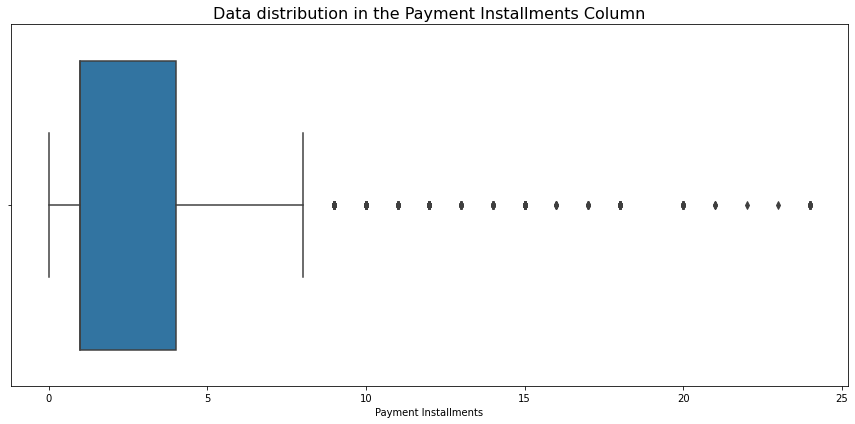

In [70]:
plt.figure( figsize=(12, 6))
sns.boxplot(order_payments,x='payment_installments')
plt.title('Data distribution in the Payment Installments Column', size=16)
plt.xlabel('Payment Installments')
plt.tight_layout()
plt.show()

## Order review

In [71]:
order_review.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99224 entries, 0 to 99223
Data columns (total 7 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   review_id                99224 non-null  object
 1   order_id                 99224 non-null  object
 2   review_score             99224 non-null  int64 
 3   review_comment_title     11568 non-null  object
 4   review_comment_message   40977 non-null  object
 5   review_creation_date     99224 non-null  object
 6   review_answer_timestamp  99224 non-null  object
dtypes: int64(1), object(6)
memory usage: 5.3+ MB


In [72]:
order_review.head(5)

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela Internet seguro e prático Parabéns a todos feliz Páscoa,2018-03-01 00:00:00,2018-03-02 10:26:53


In [73]:
display(order_review.nunique())

review_id                  98410
order_id                   98673
review_score                   5
review_comment_title        4527
review_comment_message     36159
review_creation_date         636
review_answer_timestamp    98248
dtype: int64

<AxesSubplot: >

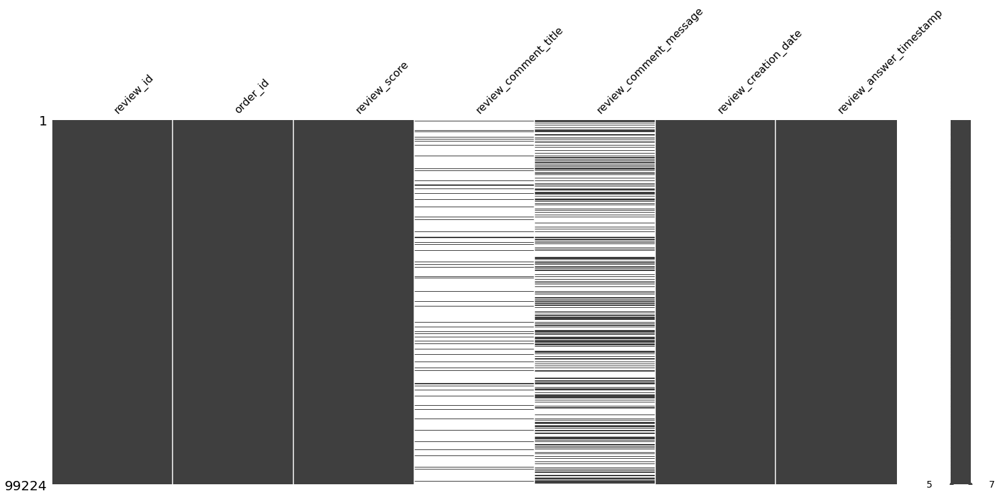

In [74]:
msno.matrix(order_review)

In [75]:
order_review['review_score'].value_counts()

review_score
5    57328
4    19142
1    11424
3     8179
2     3151
Name: count, dtype: int64

In [76]:
order_review['review_score'].iplot(kind='hist')

In [77]:
order_review['review_comment_title'].value_counts().head(22)

review_comment_title
Recomendo            423
recomendo            345
Bom                  293
super recomendo      270
Excelente            248
Muito bom            247
Ótimo                240
Super recomendo      217
Ótimo                207
Otimo                174
10                   158
Excelente            119
otimo                105
bom                   97
Muito bom             87
Boa                   86
Recomendo             62
Perfeito              57
Ótima                 55
Bom                   55
super recomendado     55
RECOMENDO             55
Name: count, dtype: int64

In [78]:
# Select the top 22 most frequent review_comment_title values
top_titles = order_review['review_comment_title'].value_counts().head(22).index.tolist()

# Filter the order_review DataFrame based on the selected titles
filtered_reviews = order_review[order_review['review_comment_title'].isin(top_titles)]

# Create the histogram of review_score
fig = go.Figure(data=[go.Histogram(x=filtered_reviews['review_score'])])
fig.update_layout(title="Histogram of Review Score for Top 22 Review Comment Titles",
                  xaxis_title="Review Score",
                  yaxis_title="Frequency")

fig.show()


In [79]:
# Filtrer les données pour les clients qui n'ont pas écrit de commentaire
no_comment_customers = order_review[order_review['review_comment_message'].isna()]['review_score']

# Obtenir le décompte des valeurs de 'review_score' pour les clients sans commentaire
no_comment_counts = no_comment_customers.value_counts()

# Obtenir le décompte global des valeurs de 'review_score' dans l'ensemble des données
overall_counts = order_review['review_score'].value_counts()

# Calculer le pourcentage du décompte sans commentaire par rapport au décompte global
percentage = (no_comment_counts / overall_counts) * 100

# Créer un DataFrame de comparaison
comparison_df = pd.DataFrame({'Sans Commentaire': no_comment_counts, 'Ensemble': overall_counts, 'Pourcentage': percentage})
comparison_df = comparison_df.fillna(0)  # Remplacer les valeurs NaN par 0
comparison_df = comparison_df.astype(int)  # Convertir les valeurs flottantes en entiers

# Afficher le DataFrame de comparaison
print(comparison_df)


              Sans Commentaire  Ensemble  Pourcentage
review_score                                         
1                         2679     11424           23
2                         1006      3151           31
3                         4622      8179           56
4                        13166     19142           68
5                        36774     57328           64


Ces résultats peuvent indiquer que les clients qui ne laissent pas de commentaire ont une expérience généralement positive et qu'ils sont plus enclins à donner des scores de revue élevés. En tant que data scientist, cette information peut être utile pour la segmentation des clients et la compréhension des différents comportements et attentes des clients dans le cadre de ce projet.

## Geolocation

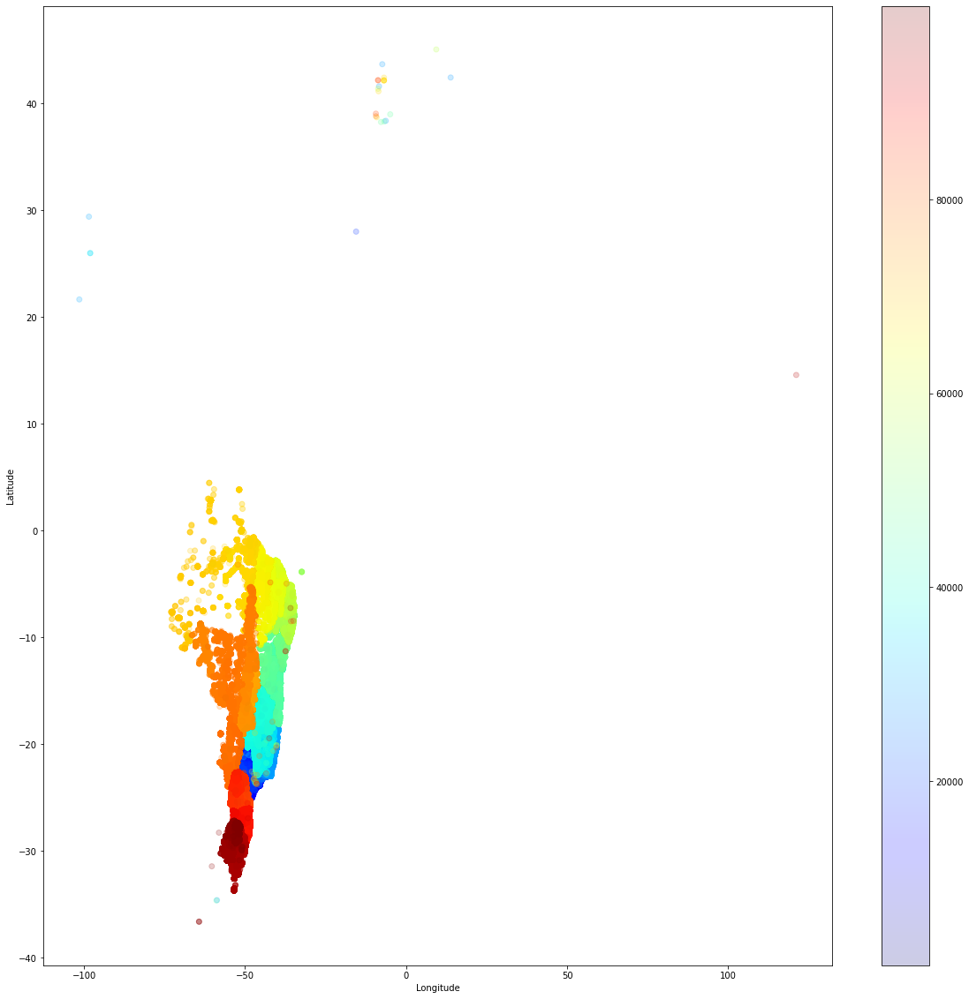

In [80]:
plt.figure(figsize=(20, 20))


# Affichage graphique des zip_code_prefix, des latitudes et longitudes associées
plt.scatter(geolocation['geolocation_lng'], geolocation['geolocation_lat'], alpha=0.2,
            c=geolocation['geolocation_zip_code_prefix'], cmap='jet')
plt.colorbar()

# Définir les labels des axes
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Afficher le graphique
plt.show()

In [81]:
#Removing outliers
geolocation = geolocation[(geolocation.geolocation_lat <= 5.27438888) &
(geolocation.geolocation_lng >= -73.98283055) &
(geolocation.geolocation_lat >= -33.75116944) &
(geolocation.geolocation_lng <= -34.79314722)]

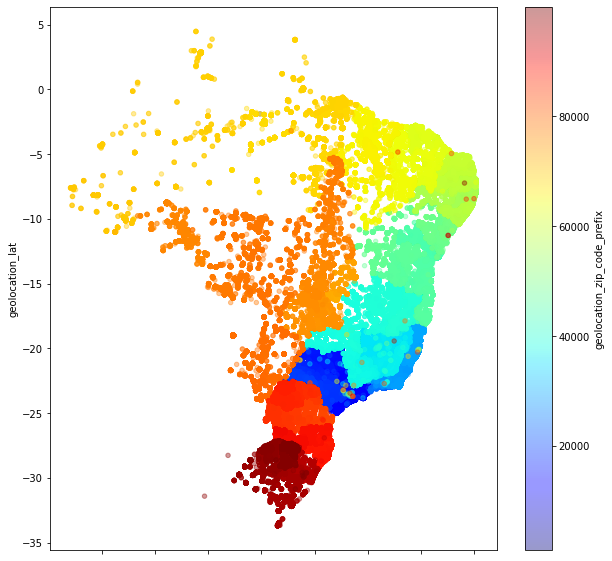

In [82]:
# Affichage graphique des zip_code_prefix,
# des latitudes et longitudes associées
geolocation.plot(kind="scatter", x="geolocation_lng", y="geolocation_lat",
         alpha=0.4, c="geolocation_zip_code_prefix",
         cmap=plt.get_cmap("jet"), colorbar=True, figsize=(10, 10))
plt.show()


##  Fusion de jeux de données

In [83]:
df= pd.merge(orders, customers,
             how= 'left',
             on= ['customer_id']).merge(order_payments,
                how='left',
                on='order_id').merge(order_items,
                how='left',
                on='order_id').merge(products,
                how='left',
                on='product_id').merge(sellers,
                how='left',
                on='seller_id').merge(order_review,
                how='left',
                on = 'order_id')

In [84]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 115723 entries, 0 to 115722
Data columns (total 34 columns):
 #   Column                         Non-Null Count   Dtype         
---  ------                         --------------   -----         
 0   order_id                       115723 non-null  object        
 1   customer_id                    115723 non-null  object        
 2   order_purchase_timestamp       115723 non-null  datetime64[ns]
 3   order_purchase_date            115723 non-null  datetime64[ns]
 4   year                           115723 non-null  int32         
 5   month                          115723 non-null  object        
 6   day                            115723 non-null  int32         
 7   hour                           115723 non-null  int32         
 8   days_since_last_order          115723 non-null  int64         
 9   customer_unique_id             115723 non-null  object        
 10  customer_zip_code_prefix       115723 non-null  int64         
 11  

In [85]:
df.nunique()

order_id                         96478
customer_id                      96478
order_purchase_timestamp         95956
order_purchase_date              12024
year                                 3
month                               12
day                                 31
hour                                24
days_since_last_order              613
customer_unique_id               93358
customer_zip_code_prefix         14889
customer_city                     4085
customer_state                      27
payment_sequential                  26
payment_type                         4
payment_installments                24
payment_value                    28547
order_item_id                       21
product_id                       32216
seller_id                         2970
price                             5859
freight_value                     6924
product_category_name               74
product_category_name_english       74
main_category_group                 22
seller_zip_code_prefix   

Nous commençons par regrouper le dataframe 'df' en utilisant les colonnes 'order_id' et 'product_id'. En calculant la taille de chaque groupe, nous obtenons le nombre d'articles dans chaque combinaison de commande et de produit. Ces informations sont ensuite stockées dans le dataframe 'quantity_order' avec une nouvelle colonne nommée 'order_item_quantity'.

Ensuite, nous fusionnons le dataframe 'quantity_order' avec le dataframe 'df' d'origine en utilisant les colonnes 'order_id' et 'product_id'. La fusion de type 'left' garantit que toutes les lignes du dataframe 'quantity_order' sont incluses dans le résultat. En supprimant les lignes en double avec la fonction 'drop_duplicates()', nous nous assurons que chaque combinaison de commande et de produit n'apparaît qu'une seule fois dans le dataframe final. Enfin, nous réinitialisons l'index et supprimons la colonne 'order_item_id'.

Ce processus nous permet de calculer la quantité d'articles pour chaque commande et produit, et de supprimer les doublons pour assurer l'unicité de chaque combinaison. Ainsi, nous pouvons connaître le nombre de fois où un produit est commandé dans le contexte de notre projet de segmentation des clients pour Olist.

In [86]:
quantity_order = df.groupby(['order_id','product_id']).size().reset_index(name='order_item_quantity')

In [87]:
df = pd.merge(quantity_order,df,how = 'left',  on=['order_id', 'product_id']).drop_duplicates().reset_index(drop=True)

In [88]:
df = df.drop(axis = 1, columns = "order_item_id")


In [89]:
df['order_item_quantity']

0         1
1         1
2         1
3         1
4         1
         ..
115718    1
115719    1
115720    1
115721    1
115722    1
Name: order_item_quantity, Length: 115723, dtype: int64

In [90]:
quantity_per_customer = df.groupby(['customer_id'])['product_id'].count().reset_index(name= 'tot_product')


In [91]:
df = pd.merge(quantity_per_customer, df,how = 'left', on=['customer_id']).drop_duplicates().reset_index(drop=True)


In [92]:
df

,customer_id,tot_product,order_id,product_id,order_item_quantity,order_purchase_timestamp,order_purchase_date,year,month,day,hour,days_since_last_order,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,payment_sequential,payment_type,payment_installments,payment_value,seller_id,price,freight_value,product_category_name,product_category_name_english,main_category_group,seller_zip_code_prefix,seller_city,seller_state,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,00012a2ce6f8dcda20d059ce98491703,1,5f79b5b0931d63f1a42989eb65b9da6e,64315bd8c0c47303179dd2e25b579d00,1,2017-11-14 16:08:26,2017-11-14 16:00:00,2017,Nov,14,16,287,248ffe10d632bebe4f7267f1f44844c9,6273,osasco,SP,1.0,credit_card,8.0,114.74,7aa4334be125fcdd2ba64b3180029f14,89.80,24.94,brinquedos,toys,leisure,18500,laranjal paulista,SP,65645c124061b43b2edc38b05ee76aab,1.0,NaN,Tudo dentro do esperado,2017-11-29 00:00:00,2017-12-04 12:00:07
1,000161a058600d5901f007fab4c27140,1,a44895d095d7e0702b6a162fa2dbeced,84183944dc7cddca87a5d384452c1d3c,1,2017-07-16 09:40:32,2017-07-16 09:00:00,2017,Jul,16,9,409,b0015e09bb4b6e47c52844fab5fb6638,35550,itapecerica,MG,1.0,credit_card,5.0,67.41,2a1348e9addc1af5aaa619b1a3679d6b,54.90,12.51,beleza_saude,health_beauty,beauty and hygiene,30494,belo horizonte,MG,862cae301754fcafa8129022c8eca937,4.0,NaN,NaN,2017-07-26 00:00:00,2017-07-27 18:17:27
2,0001fd6190edaaf884bcaf3d49edf079,1,316a104623542e4d75189bb372bc5f8d,9df2b21ec85378d71df4404712e17478,1,2017-02-28 11:06:43,2017-02-28 11:00:00,2017,Feb,28,11,547,94b11d37cd61cb2994a194d11f89682b,29830,nova venecia,ES,1.0,credit_card,10.0,195.42,46dc3b2cc0980fb8ec44634e21d2718e,179.99,15.43,bebes,baby,baby,22240,rio de janeiro,RJ,238e7cc8c4579a3d4db8f2a211db5b06,5.0,NaN,Muito bom,2017-03-07 00:00:00,2017-03-08 00:23:34
3,0002414f95344307404f0ace7a26f1d5,1,5825ce2e88d5346438686b0bba99e5ee,af3ec22cce878225aae6d9eb6c7a78eb,1,2017-08-16 13:09:20,2017-08-16 13:00:00,2017,Aug,16,13,378,4893ad4ea28b2c5b3ddf4e82e79db9e6,39664,mendonca,MG,1.0,boleto,1.0,179.35,aafe36600ce604f205b86b5084d3d767,149.90,29.45,cool_stuff,cool_stuff,leisure,88115,sao jose,SC,c3a9be1f602ecba1c7bdff5639c975fe,5.0,NaN,NaN,2017-09-14 00:00:00,2017-09-15 00:26:09
4,000379cdec625522490c315e70c7a9fb,1,0ab7fb08086d4af9141453c91878ed7a,868b3136c5b206f91b8208fbfdf2cb7c,1,2018-04-02 13:42:17,2018-04-02 13:00:00,2018,Apr,2,13,149,0b83f73b19c2019e182fd552c048a22c,4841,sao paulo,SP,1.0,boleto,1.0,107.01,4a3ca9315b744ce9f8e9374361493884,93.00,14.01,cama_mesa_banho,bed_bath_table,home,14940,ibitinga,SP,fab6aa1b4c382a27ae8625faa342c229,4.0,NaN,NaN,2018-04-14 00:00:00,2018-04-16 20:17:51
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
105302,fffecc9f79fd8c764f843e9951b11341,3,814d6a3a7c0b32b2ad929ac6328124e9,c045b19fdb30a3035c56d04c6fe2e622,3,2018-03-29 16:59:26,2018-03-29 16:00:00,2018,Mar,29,16,152,e5794df8573fa179a90a7b797fc4b71f,95630,parobe,RS,3.0,voucher,1.0,9.49,259f7b5e6e482c230e5bfaa670b6bb8f,54.90,26.46,cama_mesa_banho,bed_bath_table,home,8550,poa,SP,1252f94367f5f2497f2d62927bf24549,3.0,NaN,NaN,2018-04-11 00:00:00,2018-04-14 16:25:21
105303,fffecc9f79fd8c764f843e9951b11341,3,814d6a3a7c0b32b2ad929ac6328124e9,c045b19fdb30a3035c56d04c6fe2e622,3,2018-03-29 16:59:26,2018-03-29 16:00:00,2018,Mar,29,16,152,e5794df8573fa179a90a7b797fc4b71f,95630,parobe,RS,2.0,voucher,1.0,71.23,259f7b5e6e482c230e5bfaa670b6bb8f,54.90,26.46,cama_mesa_banho,bed_bath_table,home,8550,poa,SP,1252f94367f5f2497f2d62927bf24549,3.0,NaN,NaN,2018-04-11 00:00:00,2018-04-14 16:25:21
105304,fffeda5b6d849fbd39689bb92087f431,1,8c855550908247a7eff50281b92167a8,d5c263f4d651ba657c900ce70a4be7de,1,2018-05-22 13:36:02,2018-05-22 13:00:00,2018,May,22,13,99,afbb5a642107cf6bb1ca68e863175f03,22461,rio de janeiro,RJ,1.0,credit_card,3.0,63.13,dd55f1bb788714a40e7954c3be6df745,47.90,15.23,telefonia,telephony,electron

In [93]:
df['tot_product']

0         1
1         1
2         1
3         1
4         1
         ..
105302    3
105303    3
105304    1
105305    1
105306    2
Name: tot_product, Length: 105307, dtype: int64

In [94]:
df['order_item_quantity']

0         1
1         1
2         1
3         1
4         1
         ..
105302    3
105303    3
105304    1
105305    1
105306    2
Name: order_item_quantity, Length: 105307, dtype: int64

In [95]:
df.tot_product.equals(df.order_item_quantity)


False

La colonne 'tot_product' représente le nombre total de produits uniques achetés par chaque client, tandis que 'order_item_quantity' représente la quantité totale d'articles pour chaque combinaison de commande et de produit. Elles peuvent différer car 'tot_product' compte les produits uniques tandis que 'order_item_quantity' inclut toutes les quantités commandées.

In [96]:
df['customer_id'].value_counts()

customer_id
270c23a11d024a44c896d1894b261a83    42
92cd3ec6e2d643d4ebd0e3d6238f69e2    26
86cc80fef09f7f39df4b0dbce48e81cb    24
2ba91e12e5e4c9f56b82b86d9031d329    24
b246eeed30b362c09d867b9e598bee51    22
                                    ..
5873ae605bc4583bf32fe8ff3b582cf8     1
5873294c345e69097a4eb7473e823bb4     1
5872806a5616a6f8c60d50f4f692f7f6     1
58723c16d88f82622b9cd3888d90dd55     1
ffffa3172527f765de70084a7e53aae8     1
Name: count, Length: 96478, dtype: int64

In [97]:
pay = df.groupby('customer_id').agg({
    'payment_type': 'first',
    'payment_installments': lambda x: x.mode()[0] if len(x.mode()) > 0 else np.nan
}).reset_index()


In [98]:
pay.rename(columns={'payment_type': 'primary_payment', 'payment_installments': 'common_payment_count'}, inplace=True)


In [99]:
pay

,customer_id,primary_payment,common_payment_count
0,00012a2ce6f8dcda20d059ce98491703,credit_card,8.0
1,000161a058600d5901f007fab4c27140,credit_card,5.0
2,0001fd6190edaaf884bcaf3d49edf079,credit_card,10.0
3,0002414f95344307404f0ace7a26f1d5,boleto,1.0
4,000379cdec625522490c315e70c7a9fb,boleto,1.0
...,...,...,...
96473,fffcb937e9dd47a13f05ecb8290f4d3e,credit_card,6.0
96474,fffecc9f79fd8c764f843e9951b11341,credit_card,1.0
96475,fffeda5b6d849fbd39689bb92087f431,credit_card,3.0
96476,ffff42319e9b2d713724ae527742af25,credit_card,2.0


In [100]:
df= pd.merge(pay, df, how = 'left', on =['customer_id']).drop_duplicates().reset_index(drop=True)


In [101]:
# Save DataFrame as CSV file
df.to_csv('df_clean.csv', index=False)

## Conclusion

En conclusion, le Notebook 1 a été consacré à l'analyse exploratoire des données (EDA) pour le projet de segmentation des clients d'Olist. Nous avons effectué une exploration approfondie de l'ensemble de données, en examinant les principales caractéristiques des clients ainsi que les tendances et les schémas de comportement d'achat.

Nous avons identifié des informations clés concernant la distribution des valeurs dans les différentes variables, la fréquence d'achat des clients et les montants des transactions. Ces connaissances nous ont permis de mieux comprendre la base de clients d'Olist et de définir les prochaines étapes de notre analyse.

Le Notebook 2 se concentrera sur l'application de la méthode RFM (Récence, Fréquence, Montant) pour la segmentation des clients, ainsi que sur l'utilisation de techniques de Machine Learning telles que K-means, DBScan et CAH. Nous explorerons comment ces méthodes peuvent être utilisées pour diviser la base de clients en groupes homogènes et comment elles peuvent aider Olist à cibler ses actions marketing de manière plus efficace.